In [6]:
#import packages
import pandas as pd
import numpy as np
from scipy.signal import savgol_filter
import matplotlib.pyplot as plt
from matplotlib.widgets import RectangleSelector
import matplotlib.patches as patches
from collections import Counter
import cv2 as cv2
import os


In [7]:
df = pd.read_csv("N:\TMAZE\TMAZE_REFINED_VIDEOS\BDC5_2024-02-14T16_55_55DLC_resnet50_TMAZE DLC model May14shuffle1_300000_filtered.csv", header=[1, 2])
print(df.columns)

MultiIndex([('bodyparts',     'coords'),
            ( 'righteye',          'x'),
            ( 'righteye',          'y'),
            ( 'righteye', 'likelihood'),
            (  'lefteye',          'x'),
            (  'lefteye',          'y'),
            (  'lefteye', 'likelihood'),
            ( 'tailbase',          'x'),
            ( 'tailbase',          'y'),
            ( 'tailbase', 'likelihood')],
           )


In [8]:
# Create a dictionary to map body part names to coordinate columns
body_part_data = {}
unique_body_parts = df.columns.get_level_values(0).unique().tolist() 
unique_body_parts.remove('bodyparts')
#df.clumns  retrieves all the columns from the excell sheet 
#get_level_values(0) --> the "0" means that it is only retriving the first level of the data which is the list of body parts 
#             (First level)     (second level)
# "MultiIndex([('bodyparts',     'coords'), --> first level is 
 #           ( 'righteye',          'x'),
  #          ( 'righteye',          'y'),
   #         ( 'righteye', 'likelihood'),
    #        (  'lefteye',          'x'),
     #       (  'lefteye',          'y'),
      #      (  'lefteye', 'likelihood'),
       #     ( 'tailbase',          'x'),
        #    ( 'tailbase',          'y'),
         #   ( 'tailbase', 'likelihood')],"
         #--> unique_body_parts = ['righteye','lefteye','tailbase']
for part in unique_body_parts:
    body_part_data[part] = {
        "x": df.loc[:, (part, 'x')].to_numpy(),
        "y": df.loc[:, (part, 'y')].to_numpy(),
        "likelihood": df.loc[:, (part, 'likelihood')].to_numpy()
    }

for part in body_part_data.keys():
    #print(f"body parts: {part}")
    print(part)
    
    


righteye
lefteye
tailbase


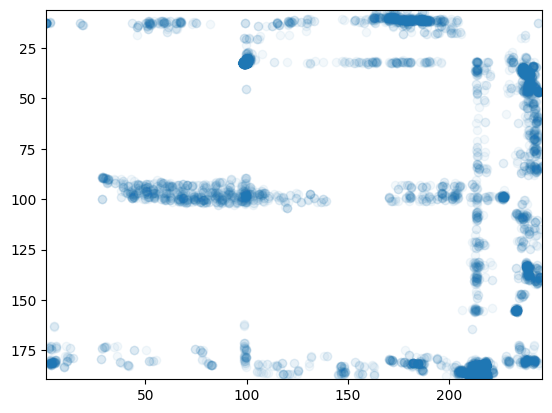

In [9]:
# Plot the data for the 'righteye' body part
fig, ax = plt.subplots()
righteye_x = body_part_data['righteye']['x']
righteye_y = body_part_data['righteye']['y']
ax.scatter(righteye_x, righteye_y, label='righteye', alpha = 0.05)

# Set the limits of the axes to fit the data
ax.set_xlim([min(righteye_x), max(righteye_x)])
ax.set_ylim([min(righteye_y), max(righteye_y)])

# Invert the y-axis
ax.invert_yaxis()

plt.show()

In [10]:
def click_event(event, x, y, flags, params): 
  
    # checking for left mouse clicks 
    if event == cv2.EVENT_LBUTTONDOWN: 
        coords.append([x,y])
        # displaying the coordinates 
        # on the Shell 
        print(x, ' ', y) 
  
        # displaying the coordinates 
        # on the image window 
        # font = cv2.FONT_HERSHEY_SIMPLEX 
        # cv2.putText(gray, str(x) + ',' +
        #             str(y), (x,y), font, 
        #             1, (255, 0, 0), 2) 
        cv2.imshow('image', gray)
  
    # checking for right mouse clicks      
    if event==cv2.EVENT_RBUTTONDOWN: 
  
        # displaying the coordinates 
        # on the Shell 
        print(x, ' ', y) 
  
        # displaying the coordinates 
        # on the image window 
        font = cv2.FONT_HERSHEY_SIMPLEX 
        b = gray[y, x, 0] 
        g = gray[y, x, 1] 
        r = gray[y, x, 2] 
        # cv2.putText(gray, str(b) + ',' +
        #             str(g) + ',' + str(r), 
        #             (x,y), font, 1, 
        #             (255, 255, 0), 2) 
        cv2.imshow('image', gray) 


In [11]:
import glob

folder = r'D:\Emory University\SOM Emanuel Lab - General\TMAZE\TMAZE_REFINED_VIDEOS'

listOfVideos = glob.glob(folder+'\\*.avi')

In [12]:
vid = cv2.VideoCapture("N:\TMAZE\TMAZE_REFINED_VIDEOS\BDC5_2024-02-14T16_55_55.mp4") #video
while (True): 
    # Capture the video frame 
    # by frame 
    ret, frame = vid.read() 
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
      # Display the resulting frame 
    cv2.imshow('frame', frame) 
      

    if cv2.waitKey(1) & 0xFF == ord('q'): 
        break

coords = []
cv2.imshow('image', gray)
cv2.setMouseCallback('image', click_event) 
cv2.waitKey(0)
cv2.destroyAllWindows()

6   42
20   60
8   130
17   138
221   6
228   13
210   176
221   188


In [13]:
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

# Global variable to store coordinates
coords = []

# Define the callback function for mouse events
def click_event(event, x, y, flags, params):
    global coords
    if event == cv2.EVENT_LBUTTONDOWN:
        if len(coords) < 4: 
            coords.append((x, y))
            print(f"Selected point ({x}, {y})")
            # Visualize the selected point
            cv2.circle(gray, (x, y), 3, (255), -1)
            cv2.imshow(windowName, gray)
        if len(coords) == 4:
            cv2.destroyWindow(windowName) 

# Set up the OpenCV window and set the mouse callback
windowName = 'Select 4 Points'
cv2.namedWindow(windowName)
cv2.setMouseCallback(windowName, click_event)

# Wait for user interaction
cv2.imshow(windowName, gray)
cv2.waitKey(0)  # Wait for a key press to proceed


Selected point (3, 8)
Selected point (6, 190)
Selected point (255, 199)
Selected point (254, 5)


-1

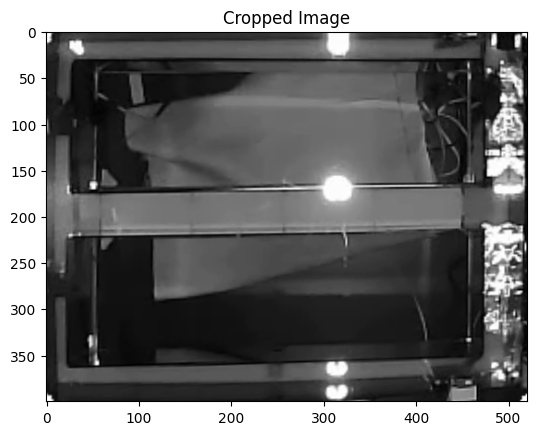

In [25]:
#crop the image

def order_points(pts):
    # Initialize a list of coordinates that will be ordered
    rect = np.zeros((4, 2), dtype="float32")

    # The top-left point will have the smallest sum; the bottom-right will have the largest sum
    s = pts.sum(axis=1)
    rect[0] = pts[np.argmin(s)]
    rect[2] = pts[np.argmax(s)]

    # The top-right will have the smallest difference; the bottom-left will have the largest difference
    diff = np.diff(pts, axis=1)
    rect[1] = pts[np.argmin(diff)]
    rect[3] = pts[np.argmax(diff)]
    
    return rect

# Ensure exactly 4 points are selected
if len(coords) == 4:
    # Convert the selected points to a numpy array
    pts = np.array(coords, dtype=np.float32)

    # Reorder points to ensure they are in the correct order
    pts = order_points(pts)

    # Define the desired size of the output cropped image
    width, height = 520, 400 

    # Define the destination points for the perspective transformation
    dst_pts = np.array([
        [0, 0],
        [width - 1, 0],
        [width - 1, height - 1],
        [0, height - 1]
    ], dtype=np.float32)

    # Get the perspective transform matrix
    M = cv2.getPerspectiveTransform(pts, dst_pts)

    # Perform the perspective transformation (cropping)
    cropped_img = cv2.warpPerspective(gray, M, (width, height))

    # Display the cropped image
    plt.imshow(cropped_img, cmap='gray')
    plt.title('Cropped Image')
    plt.show()
else:
    print("Please select exactly 4 points.")


In [34]:
def normalize_points(coords, image_width, image_height):
    # Normalize points to the range [0, 1] x [0, 1]
    normalized_coords = [(x / image_width, y / image_height) for x, y in coords]
    return normalized_coords

In [35]:

def crop_image_with_points(coords, image, output_size=(520, 400)):
    if len(coords) != 4:
        print("Please select exactly 4 points.")
        return None

    # Normalize points
    height, width = image.shape[:2]
    normalized_coords = normalize_points(coords, width, height)

    # Reorder and scale points
    pts = np.array(order_points(normalized_coords), dtype=np.float32)
    dst_pts = np.array([
        [0, 0],
        [output_size[0] - 1, 0],
        [output_size[0] - 1, output_size[1] - 1],
        [0, output_size[1] - 1]
    ], dtype=np.float32)

    # Perspective transformation
    M = cv2.getPerspectiveTransform(pts, dst_pts)
    cropped_img = cv2.warpPerspective(image, M, output_size)

    return cropped_img

# Example usage
cropped_img = crop_image_with_points(coords, gray)
if cropped_img is not None:
    plt.imshow(cropped_img, cmap='gray')
    plt.axis('off')
    plt.title("Cropped Image")
    plt.show()


AttributeError: 'list' object has no attribute 'sum'

In [27]:
def calculate_intersection(A, B, C, D):
    # Calculate the coefficients for points A and B (linear fit)
    coefficients = np.polyfit([A[0], B[0]], [A[1], B[1]], 1)

    # First line (AB)
    print('Line 1: y = ax + b')
    print('a =', coefficients[0])
    print('b =', coefficients[1]) 

    # Line AB
    polynomial = np.poly1d(coefficients)
    x_axis = np.linspace(-100, 500, 100)
    y_axis = polynomial(x_axis)
    

    # Plot the first line
    plt.plot(x_axis, y_axis, label="Line AB")
    plt.plot(A[0], A[1], 'ro', label="A")
    plt.plot(B[0], B[1], 'bo', label="B")

    # Calculate the coefficients for points C and D (linear fit)
    coefficients1 = np.polyfit([C[0], D[0]], [C[1], D[1]], 1)

    # Line CD
    print('Line 2: y = ax + b')
    print('a =', coefficients1[0])
    print('b =', coefficients1[1]) 

    # Values of the line for the second pair of points
    polynomial1 = np.poly1d(coefficients1)
    y_axis1 = polynomial1(x_axis)

    # Plot the second line
    plt.plot(x_axis, y_axis1, label="Line CD")
    plt.plot(C[0], C[1], 'go', label="C")
    plt.plot(D[0], D[1], 'yo', label="D")

    #intersection point
    if coefficients[0] != coefficients1[0]:  # Check that the lines are not parallel
        x_intersection = (coefficients1[1] - coefficients[1]) / (coefficients[0] - coefficients1[0])
        y_intersection = coefficients[0] * x_intersection + coefficients[1]
        print(f'Intersection point: ({x_intersection}, {y_intersection})')

        # Plot the intersection point
        plt.plot(x_intersection, y_intersection, 'o', label="Intersection Point")
    else:
        print("The lines are parallel and do not intersect.")
    
    # Final plot setup and display
    
    plt.grid(True)
    plt.legend()
    plt.title("Linear Fits and Intersection Point")
    plt.xlabel("X-axis")
    plt.ylabel("Y-axis")
    plt.show()
    return x_intersection, y_intersection



Line 1: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Line 2: y = ax + b
a = 194.00000000001066
b = -49271.000000002714
Intersection point: (368.22749999999075, 22165.13499999942)


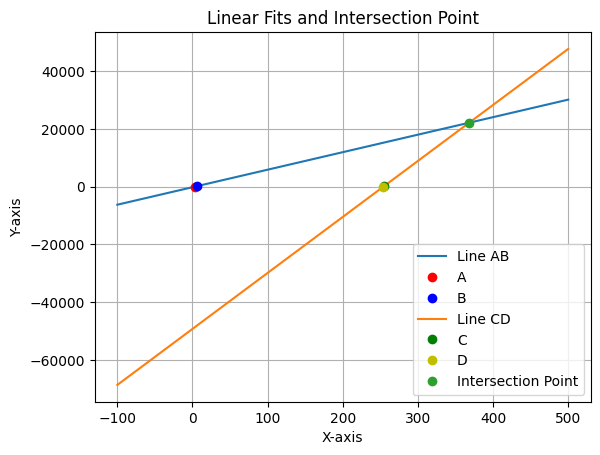

(3, 8)
(6, 190)
(255, 199)
(254, 5)
Line 1: y = ax + b
a = -0.01195219123505975
b = 8.035856573705178
Line 2: y = ax + b
a = 0.03614457831325291
b = 189.78313253012047
Intersection point: (-3778.783433133741, 53.20059880239526)


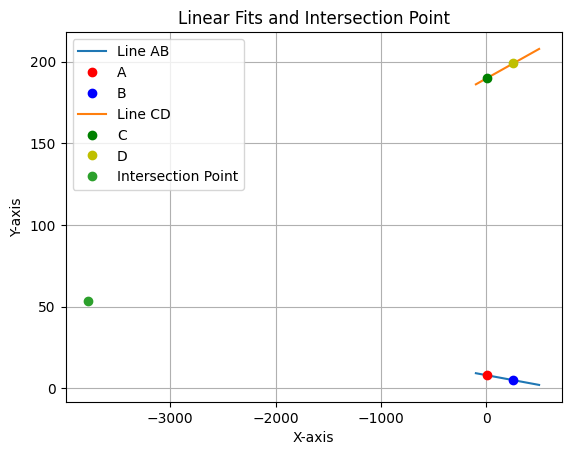

(3, 8)
(254, 5)
(6, 190)
(255, 199)
(368.22749999999075, 22165.13499999942)
(-3778.783433133741, 53.20059880239526)
E = (368.22749999999075, 22165.13499999942)
F = (-3778.783433133741, 53.20059880239526)


In [17]:
A=coords[0]
B=coords[1]
C=coords[2]
D=coords[3]

intersection_point = calculate_intersection(A, B, C, D)

A=coords[0]
B=coords[3]
C=coords[1]
D=coords[2]

intersection_point1 = calculate_intersection(A, B, C, D)


if intersection_point:
    E = intersection_point
    F = intersection_point1
    print(intersection_point)
    print(intersection_point1)

# # Print the final values of E and F
print(f'E = {E}')
print(f'F = {F}')

In [28]:
def calculate_intersection(A, B, C, D):
    # Calculate the coefficients for points A and B (linear fit)
    coefficients = np.polyfit([A[0], B[0]], [A[1], B[1]], 1)

    # First line (AB)
    print('Line 1: y = ax + b')
    print('a =', coefficients[0])
    print('b =', coefficients[1]) 

    # Line AB
    polynomial = np.poly1d(coefficients)
    x_axis = np.linspace(-100, 500, 100)
    y_axis = polynomial(x_axis)
    

    # Plot the first line
    plt.plot(x_axis, y_axis, label="Line AB")
    plt.plot(A[0], A[1], 'ro', label="A")
    plt.plot(B[0], B[1], 'bo', label="B")

    # Calculate the coefficients for points C and D (linear fit)
    coefficients1 = np.polyfit([C[0], D[0]], [C[1], D[1]], 1)

    # Line CD
    print('Line 2: y = ax + b')
    print('a =', coefficients1[0])
    print('b =', coefficients1[1]) 

    # Values of the line for the second pair of points
    polynomial1 = np.poly1d(coefficients1)
    y_axis1 = polynomial1(x_axis)

    # Plot the second line
    plt.plot(x_axis, y_axis1, label="Line CD")
    plt.plot(C[0], C[1], 'go', label="C")
    plt.plot(D[0], D[1], 'yo', label="D")

    #intersection point
    if coefficients[0] != coefficients1[0]:  # Check that the lines are not parallel
        x_intersection = (coefficients1[1] - coefficients[1]) / (coefficients[0] - coefficients1[0])
        y_intersection = coefficients[0] * x_intersection + coefficients[1]
        print(f'Intersection point: ({x_intersection}, {y_intersection})')

        # Plot the intersection point
        plt.plot(x_intersection, y_intersection, 'o', label="Intersection Point")
    else:
        print("The lines are parallel and do not intersect.")
    
    # Final plot setup and display
    return x_intersection, y_intersection

Line 1: y = ax + b
a = -0.01195219123505975
b = 8.035856573705178
Line 2: y = ax + b
a = 0.03614457831325291
b = 189.78313253012047
Intersection point: (-3778.783433133741, 53.20059880239526)
Line 1: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Line 2: y = ax + b
a = 194.00000000001066
b = -49271.000000002714
Intersection point: (368.22749999999075, 22165.13499999942)
A = (3, 8)
B = (254, 5)
C = (6, 190)
D = (255, 199)


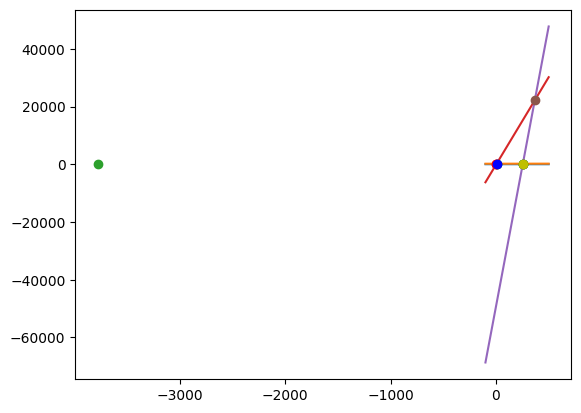

In [19]:
A=coords[0]
B=coords[3]
C=coords[1]
D=coords[2]

if len(A) != 2 or len(B) != 2 or len(C) != 2 or len(D) != 2:
    print("Error: One or more coordinates are not properly defined.")

calculate_intersection(A, B, C, D)
calculate_intersection(A, C, B, D)
print(f"A = {A}")
print(f"B = {B}")
print(f"C = {C}")
print(f"D = {D}")

# Ensure A, B, C, and D are valid coordinates
if len(A) != 2 or len(B) != 2 or len(C) != 2 or len(D) != 2:
    print("Error: One or more coordinates are not properly defined.")
else:
    pass
#OE and OF
folder_path = r'N:\TMAZE\TMAZE_REFINED_VIDEOS'
file_pattern = '*.csv' 
files = glob.glob(os.path.join(folder_path, file_pattern)) 

file_path = r"N:\TMAZE\TMAZE_REFINED_VIDEOS\BDC5_2024-02-14T16_55_55DLC_resnet50_TMAZE DLC model May14shuffle1_300000_filtered.csv"

df = pd.read_csv(file_path, header=[1, 2])

# Combine x and y into a single array for each body part
right_eye_coords = np.column_stack((df[('righteye', 'x')].values, df[('righteye', 'y')].values))
left_eye_coords = np.column_stack((df[('lefteye', 'x')].values, df[('lefteye', 'y')].values))
tail_base_coords = np.column_stack((df[('tailbase', 'x')].values, df[('tailbase', 'y')].values))

right_eye_coords_with_likelihood = np.column_stack((df[('righteye', 'x')].values, df[('righteye', 'y')].values, df[('righteye', 'likelihood')].values))
left_eye_coords_with_likelihood = np.column_stack((df[('lefteye', 'x')].values, df[('lefteye', 'y')].values, df[('lefteye', 'likelihood')].values))
tail_base_coords_with_likelihood = np.column_stack((df[('tailbase', 'x')].values, df[('tailbase', 'y')].values, df[('tailbase', 'likelihood')].values))

O = right_eye_coords_with_likelihood[0]
O1 = left_eye_coords_with_likelihood[0]
O2 = tail_base_coords_with_likelihood[0]

# Os = df()


Line 1: y = ax + b
a = 143.19258093657112
b = -30562.311096820475
Line 2: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Intersection point: (368.22749999999047, 22165.1349999994)
Line 1: y = ax + b
a = 0.03255504586479527
b = 176.21906678119274
Line 2: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Intersection point: (5.775941255170341, 176.40710281366717)
Line 1: y = ax + b
a = 143.19258093657112
b = -30562.311096820475
Line 2: y = ax + b
a = 194.00000000001066
b = -49271.000000002714
Intersection point: (368.22749999999127, 22165.13499999952)
Line 1: y = ax + b
a = 0.03255504586479527
b = 176.21906678119274
Line 2: y = ax + b
a = 194.00000000001066
b = -49271.000000002714
Intersection point: (254.9253514087031, 184.51817328840212)
Line 1: y = ax + b
a = 81.65761147976578
b = -7903.443131165264
Line 2: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Intersection point: (368.22749999999013, 22165.134999999384)
Line 1: y = ax + b
a = -0.0076416486906476

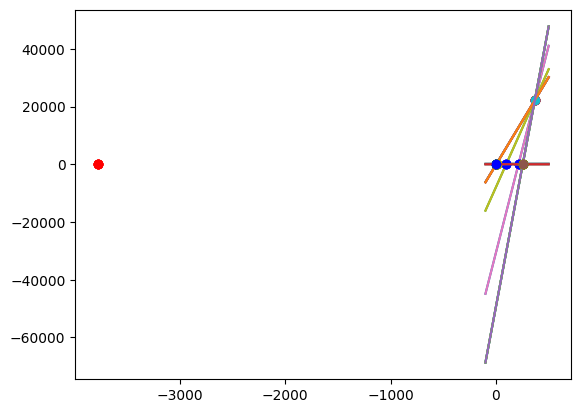

In [20]:
calculate_intersection(E, O, A, C)
calculate_intersection(F, O, A, C)
calculate_intersection(E, O, B, D)
calculate_intersection(F, O, B, D)

calculate_intersection(E, O1, A, C)
calculate_intersection(F, O1, A, C)
calculate_intersection(E, O1, B, D)
calculate_intersection(F, O1, B, D)

A2 = calculate_intersection(E, O2, A, C)
B2 = calculate_intersection(E, O2, B, D)
C2 = calculate_intersection(F, O2, A, C)
D2 = calculate_intersection(F, O2, B, D)

In [21]:
coefficients = np.polyfit([E[0], O[0]], [E[1], O[1]], 1)

    # First line (AB)
print('Line 1: y = ax + b')
print('a =', coefficients[0])
print('b =', coefficients[1]) 

d2 = ( (A2[1]-O2[1])**2 + (A2[0]-O2[0])**2 ) ** 0.5
d2_1 = ( (B2[1]-O2[1])**2 + (B2[0]-O2[0])**2 ) ** 0.5
d2_2 = ( (C2[1]-O2[1])**2 + (C2[0]-O2[0])**2 ) ** 0.5
d2_3 = ( (D2[1]-O2[1])**2 + (D2[0]-O2[0])**2 ) ** 0.5

r2 = d2/d2_1
r2_1 = d2_2/d2_3
#wrong
# N2 = (O2[0]*r2,O2[1]*r2_1)

print(r2)
print(r2_1)
# print(N2)
# use the ratio as coordinates - x axix vertical and y axis horizontal

Line 1: y = ax + b
a = 143.19258093657112
b = -30562.311096820475
0.9999999999999987
0.005579601743945184


In [22]:
def calculate_intersection(A, B, C, D):
    # Calculate the coefficients for points A and B (linear fit)
    coefficients = np.polyfit([A[0], B[0]], [A[1], B[1]], 1)

    # Line AB
    polynomial = np.poly1d(coefficients)
    x_axis = np.linspace(-100, 500, 100)
    y_axis = polynomial(x_axis)

    # Calculate the coefficients for points C and D (linear fit)
    coefficients1 = np.polyfit([C[0], D[0]], [C[1], D[1]], 1)

    # Values of the line for the second pair of points
    polynomial1 = np.poly1d(coefficients1)
    y_axis1 = polynomial1(x_axis)

    #intersection point
    if coefficients[0] != coefficients1[0]:  # Check that the lines are not parallel
        x_intersection = (coefficients1[1] - coefficients[1]) / (coefficients[0] - coefficients1[0])
        y_intersection = coefficients[0] * x_intersection + coefficients[1]

    else:
        print("The lines are parallel and do not intersect.")
    
    # Final plot setup and display
    return x_intersection, y_intersection



In [29]:
def calculate_distance(p1, p2):
    return np.sqrt((p1[0] - p2[0])**2 + (p1[1] - p2[1])**2)

N2_values = []

for i in range(len(df)):

    O2 = tail_base_coords[i]

    if intersection_point:
        E = intersection_point
        F = intersection_point1
    
    A2 = calculate_intersection(E, O2, A, C)
    B2 = calculate_intersection(E, O2, B, D)
    C2 = calculate_intersection(F, O2, A, C)
    D2 = calculate_intersection(F, O2, B, D)

    d2 = calculate_distance(A2, O2)
    d2_1 = calculate_distance(B2, O2)
    d2_2 = calculate_distance(C2, O2)
    d2_3 = calculate_distance(D2, O2)

    r2 = d2 / d2_1 if d2_1 != 0 else 0
    r2_1 = d2_2 / d2_3 if d2_3 != 0 else 0

    N2 = (O2[0] * r2, O2[1] * r2_1)
    N2_values.append(N2)


print(N2_values)

Line 1: y = ax + b
a = 60.43358383826278
b = -88.17249280392804
Line 2: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Intersection point: (368.2274999999903, 22165.13499999939)
Line 1: y = ax + b
a = 60.43358383826278
b = -88.17249280392804
Line 2: y = ax + b
a = 194.00000000001066
b = -49271.000000002714
Intersection point: (368.22749999999075, 22165.13499999942)
Line 1: y = ax + b
a = -0.012481518597323724
b = 6.035643106477663
Line 2: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Intersection point: (2.9670100601412126, 5.998610315233563)
Line 1: y = ax + b
a = -0.012481518597323724
b = 6.035643106477663
Line 2: y = ax + b
a = 194.00000000001066
b = -49271.000000002714
Intersection point: (253.98899729233642, 2.8654747132577607)
Line 1: y = ax + b
a = 60.43358383826278
b = -88.17249280392804
Line 2: y = ax + b
a = 60.666666666666615
b = -173.99999999999986
Intersection point: (368.2274999999903, 22165.13499999939)
Line 1: y = ax + b
a = 60.43358383826278
b = 

KeyboardInterrupt: 

Error in callback <function _draw_all_if_interactive at 0x0000023B74EF6840> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

Error in callback <function flush_figures at 0x0000023B76805B20> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

In [32]:
def calculate_distance(p1, p2):
    return np.sqrt((p1[0] - p2[0])**2 + (p1[1] - p2[1])**2)

N_right_eye = []
N_left_eye = []
N_tail_base = []

for i in range(len(right_eye_coords)):
    O_right_eye = right_eye_coords[i]
    O_left_eye = left_eye_coords[i]
    O_tail_base = tail_base_coords[i]

    d_right_eye_A = calculate_distance(A, O_right_eye)
    d_right_eye_B = calculate_distance(B, O_right_eye)
    d_left_eye_C = calculate_distance(C, O_left_eye)
    d_left_eye_D = calculate_distance(D, O_left_eye)
    d_tail_base_A = calculate_distance(A, O_tail_base)
    d_tail_base_D = calculate_distance(D, O_tail_base)

    r_right_eye = d_right_eye_A / d_right_eye_B if d_right_eye_B != 0 else 0
    r_left_eye = d_left_eye_C / d_left_eye_D if d_left_eye_D != 0 else 0
    r_tail_base = d_tail_base_A / d_tail_base_D if d_tail_base_D != 0 else 0

    N_right_eye.append((O_right_eye[0] * r_right_eye, O_right_eye[1] * r_right_eye))
    N_left_eye.append((O_left_eye[0] * r_left_eye, O_left_eye[1] * r_left_eye))
    N_tail_base.append((O_tail_base[0] * r_tail_base, O_tail_base[1] * r_tail_base))

print("N values for right eye:", N_right_eye)
print("N values for left eye:", N_left_eye)
print("N values for tail base:", N_tail_base)


N values for right eye: [(323.3417727047735, 275.89735882112393), (319.47422458502166, 278.6214500110298), (319.47422458502166, 278.6214500110298), (326.6020418139025, 280.5759092450265), (326.6020418139025, 280.5759092450265), (319.4847719017998, 278.6987409364608), (319.60909709503113, 278.6085026305498), (319.60909709503113, 278.6085026305498), (319.60909709503113, 278.6085026305498), (323.5856380602368, 275.8144160088334), (323.31890069392887, 275.70952002453623), (323.31890069392887, 275.70952002453623), (319.45011817606724, 278.4218628614618), (319.45011817606724, 278.4218628614618), (319.45895011497794, 278.42536436995726), (329.5220500778472, 277.97948135875293), (329.6282910233239, 278.00803959901435), (330.03157137441303, 278.1605083691987), (330.78986764707787, 278.4433715005331), (330.78986764707787, 278.4433715005331), (330.96032527770956, 278.33433690267987), (330.59458467103866, 278.2017136353679), (329.9834636253232, 277.9797193451984), (329.8338341661844, 277.916345505

In [33]:
#The DataFrame.columns attribute in Pandas is used to access the column labels of a DataFrame.
#It returns an Index object representing the names of the columns in the DataFrame
df.columns = ['_'.join(col).strip() for col in df.columns.values] #join(col).strip() - Split, strip, and join in one line

# df.copy: create a copy of a DataFrame.
df_new = df.copy()

df_new[('righteye', 'x')] = [n[0] for n in N_right_eye]
df_new[('righteye', 'y')] = [n[1] for n in N_right_eye]
df_new[('lefteye', 'x')] = [n[0] for n in N_left_eye]
df_new[('lefteye', 'y')] = [n[1] for n in N_left_eye]
df_new[('tailbase', 'x')] = [n[0] for n in N_tail_base]
df_new[('tailbase', 'y')] = [n[1] for n in N_tail_base]

# Save the new DataFrame to a new Excel file
output_path = r"C:\Users\custe\Downloads\new1.xlsx"
df_new.to_excel(output_path, index=False)

print("Modified coordinates saved to:", output_path)

Modified coordinates saved to: C:\Users\custe\Downloads\new1.xlsx


In [43]:

n2_df = pd.DataFrame(N2_values, columns=['N2_x', 'N2_y'])
n2_df.to_csv('.csv', index=False)

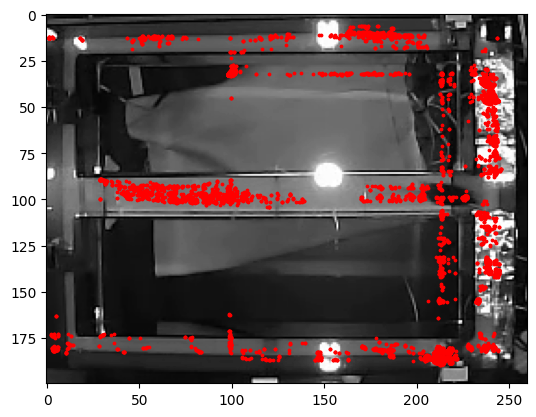

In [44]:
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

plt.imshow(gray,cmap='gray')


# plt.figure(figsize=(16,10))
x = np.array(body_part_data['righteye']['x'])
y = np.array(body_part_data['righteye']['y'])
plt.scatter(x,y,3,color='r')
plt.show()

In [21]:
body_part_data['righteye']['likelihood']

array([0.38573518, 0.38573518, 0.40786493, ..., 0.77240294, 0.54045439,
       0.53982532])

In [22]:
test = body_part_data['righteye']['x']#
test[body_part_data['righteye']['likelihood'] < 0.95] = np.nan

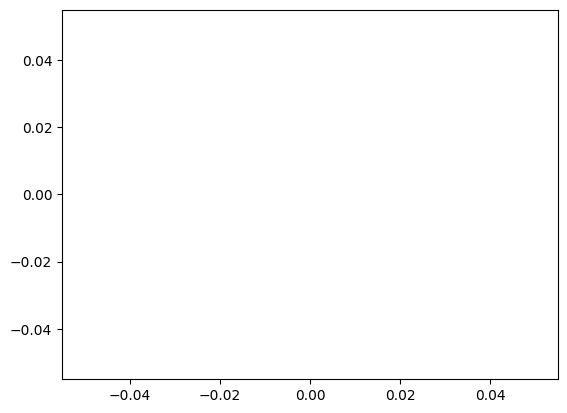

In [23]:
plt.plot(body_part_data['righteye']['x'][:50])
plt.plot(test[:50])

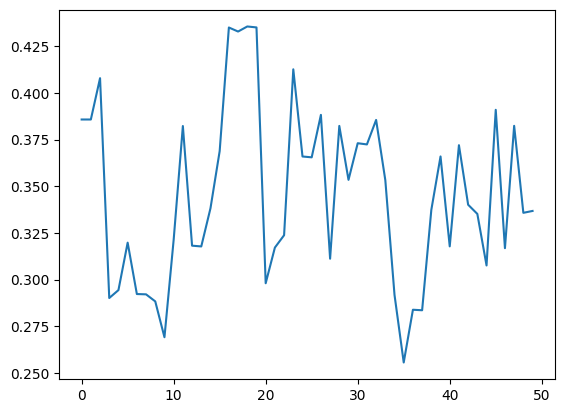

In [24]:
plt.plot(body_part_data['righteye']['likelihood'][:50])

In [25]:
trial_starts = [50, 75, 80, 200, 2500] ## when the door opens
texture_contact_onset = [...] ## when the mouse crosses to the textured section


trial_ends = [55, 79, 88, 213, 2580] ## when the mouse chooses a port

In [26]:
#a test step, function not defined

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)



plt.imshow(gray,cmap='gray')


# plt.figure(figsize=(16,10))
for trial in zip(trial_starts,trial_ends):


    x = np.array(body_part_data['righteye']['x'])[trial[0]:trial[1]]
    y = np.array(body_part_data['righteye']['y'])[trial[0]:trial[1]]
    plt.plot(x,y)
plt.show()




NameError: name 'img' is not defined

Text(0.5, 1.0, 'Contours on Original Image')

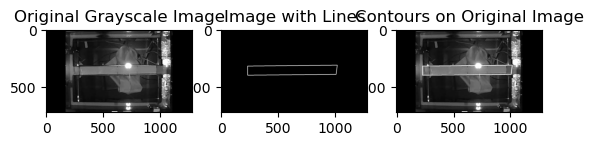

In [ ]:
#click to have the maze section selected (further analysis with the speed pass the maze and the relation of sppeed vs correctness can be investigated further)
src = np.zeros(gray.shape, dtype=np.uint8)

for i in range(len(coords)):
    cv2.line(src, coords[i], coords[(i+1) % len(coords)], (255), 3)
contours, _ = cv2.findContours(src, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contour_img = gray.copy()
cv2.drawContours(contour_img, contours, -1, (255, 0, 0), 2)  # (255, 0, 0) is blue in BGR

# Plot the results
plt.subplot(1, 3, 1)
plt.imshow(gray, cmap='gray')
plt.title('Original Grayscale Image')

plt.subplot(1, 3, 2)
plt.imshow(src, cmap='gray')
plt.title('Image with Lines')

plt.subplot(1, 3, 3)
plt.imshow(contour_img, cmap='gray')
plt.title('Contours on Original Image')



In [ ]:
#Go through individual doors - drag and release to capture the door
import numpy as np
import matplotlib.pyplot as plt
import cv2
drawing = False
ix,iy = -1,-1
coords = []
def draw_rectangle(event, x, y, flags, param):
   global ix, iy, drawing, gray, coordsq
   if event == cv2.EVENT_LBUTTONDOWN:
      drawing = True
      ix = x
      iy = y
   elif event == cv2.EVENT_LBUTTONUP:
      drawing = False
      cv2.rectangle(gray, (ix, iy),(x, y),(0, 255, 255),-1)
      coords.append([ix, iy, x, y])


vid = cv2.VideoCapture("D:\Emory University\SOM Emanuel Lab - General\TMAZE\TMAZE_REFINED_VIDEOS\BDC32024-01-25T17_15_36.mp4")
ret, frame = vid.read() 
gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
doorCoords = {}
for door in range(4):
   windowName = 'Draw Door {}'.format(door)
   cv2.namedWindow(windowName)
   cv2.setMouseCallback(windowName,  draw_rectangle)

   while True:
      cv2.imshow(windowName, gray) 
      if cv2.waitKey(0):
         break
   cv2.destroyAllWindows()
   doorCoords[door] = coords[-1]


doorTraces = {}
for door in range(4):
    doorTraces[door] = []

# Convert the first frame to grayscale
gray1 = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
while True:
    # Read the next frame
    ret, frame2 = vid.read()
    if not ret:
        break

    # Convert the current frame to grayscale
    gray2 = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)
  
    # Compute the absolute difference between the current frame and the previous frame
    diff = cv2.absdiff(gray1, gray2) 

    # Apply a threshold to get the binary image
    _, thresh = cv2.threshold(diff, 15, 255, cv2.THRESH_BINARY)
    
    
    doorImages = {}
    for door in range(4):
        doorImages[door] = thresh[doorCoords[door][1]:doorCoords[door][3], doorCoords[door][0]:doorCoords[door][2]]
        
    # Optional: Apply some morphological operations to reduce noise
    # kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
    # thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

    # Highlight the motion areas in the original frame
    motion_areas = cv2.bitwise_and(frame2, frame2, mask=thresh)

    # # Display the original frame and the thresholded difference
    # cv2.imshow('Original', frame2)
    # cv2.imshow('Motion Detection', motion_areas)
    
    
    
    for door in range(4):
        doorTraces[door].append(np.sum(doorImages[door]))
  

    # Update the previous frame
    gray1 = gray2
    
    # Break the loop on 'q' key press
    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

# Release the video capture object and close all OpenCV windows
vid.release()
cv2.destroyAllWindows()

<>:20: SyntaxWarning: invalid escape sequence '\E'
<>:20: SyntaxWarning: invalid escape sequence '\E'
C:\Users\pliu79\AppData\Local\Temp\ipykernel_39948\1370055919.py:20: SyntaxWarning: invalid escape sequence '\E'
  vid = cv2.VideoCapture("D:\Emory University\SOM Emanuel Lab - General\TMAZE\TMAZE_REFINED_VIDEOS\BDC32024-01-25T17_15_36.mp4")


In [ ]:
#trying to gothrough the whole folder - not yet finished
import numpy as np
import matplotlib.pyplot as plt
import cv2
import glob

## identify videos
folder = r'D:\Emory University\SOM Emanuel Lab - General\TMAZE\TMAZE_REFINED_VIDEOS'
listOfVideos = glob.glob(folder+'\\*.avi')


drawing = False
ix,iy = -1,-1
coords = []
frameCounter = 0
def draw_rectangle(event, x, y, flags, param):
   global ix, iy, drawing, gray, coords
   if event == cv2.EVENT_LBUTTONDOWN:
      drawing = True
      ix = x
      iy = y
   elif event == cv2.EVENT_LBUTTONUP:
      drawing = False
      cv2.rectangle(gray, (ix, iy),(x, y),(0, 255, 255),-1)
      coords.append([ix, iy, x, y])

for video in listOfVideos:
    vid = cv2.VideoCapture("D:\Emory University\SOM Emanuel Lab - General\TMAZE\TMAZE_REFINED_VIDEOS\BDC32024-01-25T17_15_36.mp4") ##  video
    ret, frame = vid.read() 
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    doorCoords = {}
    for door in range(4):
    windowName = 'Draw Door {}'.format(door)
    cv2.namedWindow(windowName)
    cv2.setMouseCallback(windowName,  draw_rectangle)

    while True:
        cv2.imshow(windowName, gray) 
        if cv2.waitKey(0):
            break
    cv2.destroyAllWindows()
    doorCoords[door] = coords[-1]


    doorTraces = {}
    for door in range(4):
        doorTraces[door] = []

    # Convert the first frame to grayscale
    gray1 = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    while True:
        # Read the next frame
        ret, frame2 = vid.read()
        if not ret:
            break

        # Convert the current frame to grayscale
        gray2 = cv2.cvtColor(frame2, cv2.COLOR_BGR2GRAY)
    
        # Compute the absolute difference between the current frame and the previous frame
        diff = cv2.absdiff(gray1, gray2) 

        # Apply a threshold to get the binary image
        _, thresh = cv2.threshold(diff, 5, 255, cv2.THRESH_BINARY)
        
        
        doorImages = {}
        for door in range(4):
            doorImages[door] = thresh[doorCoords[door][1]:doorCoords[door][3], doorCoords[door][0]:doorCoords[door][2]]
            
        # Optional: Apply some morphological operations to reduce noise
        # kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))
        # thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

        # Highlight the motion areas in the original frame
        #motion_areas = cv2.bitwise_and(frame2, frame2, mask=thresh)

        # # Display the original frame and the thresholded difference
        # cv2.imshow('Original', frame2)
        # cv2.imshow('Motion Detection', motion_areas)
        
        
        
        for door in range(4):
            doorTraces[door].append(np.sum(doorImages[door]))
    

        # Update the previous frame
        gray1 = gray2
        frameCounter += 1
        
        if frameCounter % 200 == 0:
            print('On frame {}'.format(frameCounter))
        # Break the loop on 'q' key press
        if cv2.waitKey(30) & 0xFF == ord('q'):
            break

    # Release the video capture object and close all OpenCV windows
    vid.release()
    cv2.destroyAllWindows()
    
    
    ### save doorTraces

IndentationError: expected an indented block after 'for' statement on line 32 (849838315.py, line 33)

In [ ]:
np.save

<function save at 0x0000026257DE8170>

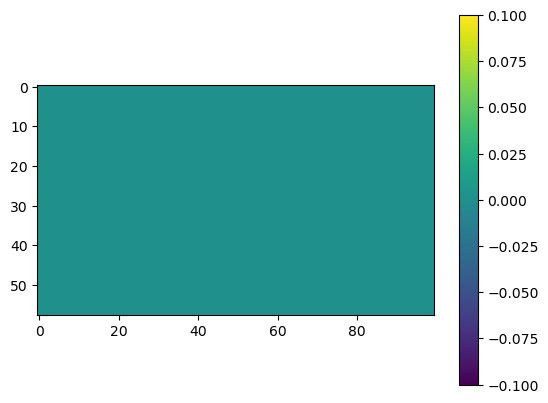

In [ ]:
plt.imshow(doorImages[2])
plt.colorbar()

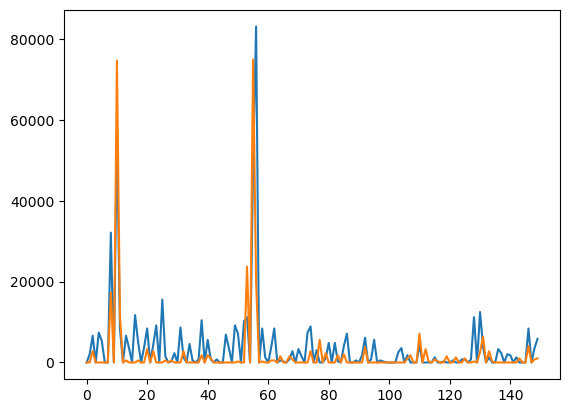

In [ ]:
# plt.plot(doorTraces[0][:])
# plt.plot(doorTraces[1][:])
plt.plot(doorTraces[0][3500:3650])
plt.plot(doorTraces[1][3500:3650])
#save the dic in according to the dlc file name - 

In [ ]:
door1 = np.array(doorTraces[0]) > 30000
door2 = np.array(doorTraces[1]) > 30000
door3 = np.array(doorTraces[2]) > 30000
door4 = np.array(doorTraces[3]) > 30000

In [ ]:
door1_filtered = np.zeros(len(door1),dtype=bool)
for n in range(len(door1)):
    try:
        if door1[n+1] or door1[n]:
            door1_filtered[n:n+2] = True
    except:
        pass
        
door2_filtered = np.zeros(len(door2),dtype=bool)
for n in range(len(door2)):
    try:
        if door2[n+1] or door2[n]:
            door2_filtered[n:n+2] = True
    except:
        pass

In [ ]:
bothDoorsChanging = np.bitwise_and(door1_filtered,door2_filtered)

In [ ]:
test = np.where(bothDoorsChanging[1:] > bothDoorsChanging[:-1])[0]


In [ ]:
test.shape


(100,)

In [ ]:
test

array([ 1457,  1502,  2081,  2186,  2791,  2881,  3508,  3553,  3874,
        3917,  4361,  4406,  4721,  4768,  5233,  5290,  6206,  6281,
        6614,  6662,  7010,  7046,  7442,  7478,  7874,  7946,  8237,
        8302,  8914,  9011,  9619,  9673,  9992, 10181, 10600, 10855,
       11267, 11432, 11971, 12007, 12649, 12773, 13186, 13228, 13594,
       13672, 14065, 14237, 14569, 14681, 14992, 15038, 15878, 15983,
       16616, 16877, 17251, 17293, 17714, 17764, 18275, 18410, 18940,
       18998, 19306, 19400, 19901, 19943, 20372, 20456, 20891, 20945,
       21346, 21532, 22048, 22117, 22436, 22522, 23101, 23179, 23764,
       23803, 24149, 24206, 24542, 24596, 24911, 25039, 25481, 25543,
       25897, 25936, 26368, 26504, 27076, 27116, 27496, 27565, 28451,
       28526], dtype=int64)

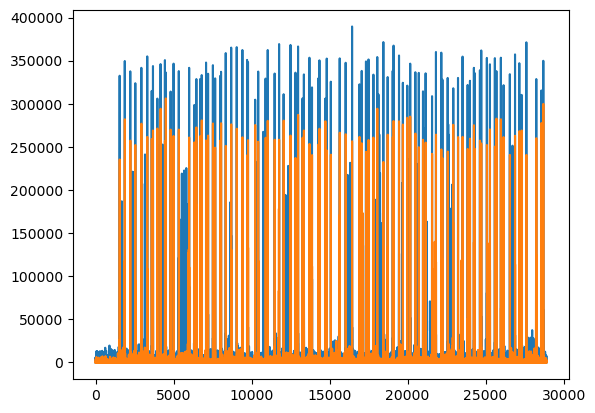

In [ ]:
#x axis is frame y axis is pixel change
for door in range(2,4):
    plt.plot(doorTraces[door])

In [ ]:
test = np.where(bothDoorsChanging[1:] < bothDoorsChanging[:-1])[0]

In [ ]:
test

array([ 1459,  1505,  2086,  2188,  2795,  2882,  3511,  3556,  3877,
        3920,  4364,  4408,  4724,  4769,  5237,  5293,  6209,  6284,
        6619,  6665,  7013,  7049,  7445,  7481,  7877,  7949,  8240,
        8303,  8917,  9013,  9623,  9674,  9995, 10184, 10604, 10856,
       11270, 11434, 11975, 12008, 12652, 12776, 13189, 13229, 13597,
       13675, 14068, 14240, 14572, 14683, 14995, 15041, 15883, 15986,
       16621, 16879, 17254, 17294, 17717, 17765, 18278, 18412, 18943,
       19001, 19310, 19402, 19904, 19945, 20377, 20459, 20894, 20947,
       21349, 21533, 22051, 22118, 22439, 22523, 23104, 23180, 23767,
       23804, 24152, 24208, 24547, 24598, 24914, 25040, 25486, 25544,
       25900, 25937, 26371, 26507, 27079, 27121, 27499, 27566, 28456,
       28529], dtype=int64)

In [ ]:
#reelative coordinates


src = np.zeros(gray.shape, dtype=np.uint8)

src = np.zeros(gray.shape, dtype=np.uint8)

for i in range(len(coords)):
    cv2.line(src, coords[i], coords[(i+1) % len(coords)], (255), 3)
contours, _ = cv2.findContours(src, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contour_img = gray.copy()
cv2.drawContours(contour_img, contours, -1, (255, 0, 0), 2)  # (255, 0, 0) is blue in BGR

# Plot the results
plt.subplot(1, 3, 1)
plt.imshow(gray, cmap='gray')
plt.title('Original Grayscale Image')

plt.subplot(1, 3, 2)
plt.imshow(src, cmap='gray')
plt.title('Image with Lines')

plt.subplot(1, 3, 3)
plt.imshow(contour_img, cmap='gray')
plt.title('Contours on Original Image')



<IPython.core.display.Javascript object>

Text(0.5, 1.0, 'Contours on Original Image')

1. surgery  - ready to do surgery - pencil for mark
2. code - interactive part
3. printing - innate preference - file cannot be read by printer (1/2; doing 1/4 instead)
